# Evaluation of RISE, Grad-CAM, RISE-CAM, and RISExCAM
RISE-CAM is an Explainable AI algorithm based on the mechanisms of two classic Explainable AI algorithms--RISE and Grad-CAM.

In this notebook, three algorithms along with RISExCAM (product of RISE and Grad-CAM) will be evaluated using **insertion** and **deletion**.

For the introduction between alrgorithms, please read Introduction_RISECAM.ipynb.

## Preparation

### Import nessasary libraries

In [1]:
import os
import numpy as np
from matplotlib import pyplot as plt
from PIL import Image
import json

import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
from torchvision import transforms
import torchvision.models as models

cudnn.benchmark = True
torch.cuda.get_device_name()

c:\Users\choulwu2\AppData\Local\Programs\Python\Python311\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


'NVIDIA GeForce RTX 2080 Ti'

### Define or import functions

In [2]:
from algorithms import rise, gradcam, risecam, get_class_name, tensor_imshow, blur, auc, CausalMetric

# Set the size of the input image.
input_size = (224, 224)

# Function that opens image from disk, normalizes it and converts to tensor
read_tensor = transforms.Compose([
    lambda x: Image.open(x),
    transforms.Resize(input_size),
    transforms.ToTensor(),
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    ),
    lambda x: torch.unsqueeze(x, 0)
])

# Image preprocessing function
preprocess = transforms.Compose([
    transforms.Resize(input_size),
    transforms.ToTensor(),
    # Normalization for ImageNet
    transforms.Normalize(
        mean=[0.485, 0.456, 0.406],
        std=[0.229, 0.224, 0.225]
    ),
])

input_tensor = read_tensor('examples/antelope.jpg')

### Load black-box model

In [3]:
# Load black box model for explanations
model = models.resnet50(True)
model = nn.Sequential(model, nn.Softmax(dim=1))
model = model.eval()
model = model.cuda()

for p in model.parameters():
    p.requires_grad = False

c:\Users\choulwu2\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:135: UserWarning: Using 'weights' as positional parameter(s) is deprecated since 0.13 and may be removed in the future. Please use keyword parameter(s) instead.
  warnings.warn(
c:\Users\choulwu2\AppData\Local\Programs\Python\Python311\Lib\site-packages\torchvision\models\_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


## Preparing substrate functions

For our causal metrics we need functions that define how we delete/insert pixels. Specifically, we define mapping from old pixels to new pixels. We use zero substrate for deletion and blurred image substrate for insertion.

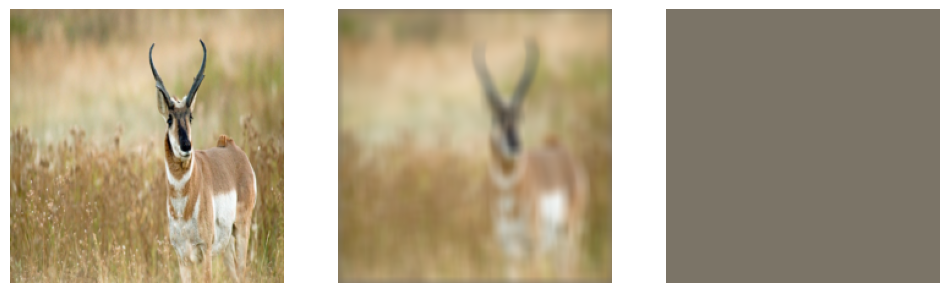

In [4]:
plt.figure(figsize=(12, 4))
plt.subplot(131)
plt.axis('off')
tensor_imshow(input_tensor[0])

plt.subplot(132)
plt.axis('off')
tensor_imshow(blur(input_tensor, klen=11, nsig=5)[0])

plt.subplot(133)
plt.axis('off')
tensor_imshow(torch.zeros_like(input_tensor)[0])

plt.show()

## Obtain the saliency maps of the algorithms
Obtain the saliency maps from RISE, Grad-CAM, RISE-CAM, and RISExCAM for the later evaluation.

In [5]:
# Get the predicted class.
probabilities, classes = torch.topk(model(input_tensor.cuda()), k=1)
probabilities, classes = probabilities[0], classes[0]
probabilities.item(), classes.item()

(0.7716467976570129, 353)

Loading masks.


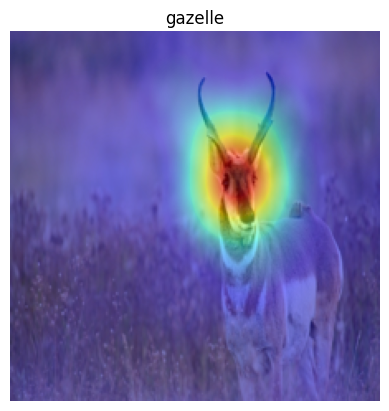

In [6]:
# Get and show the saliency map of RISE.
rise_sal = rise(model, input_tensor, input_size=input_size, mask_path='masks_6000.npy')

tensor_imshow(input_tensor[0])
plt.axis('off')
plt.title(get_class_name(classes))
plt.imshow(rise_sal, cmap='jet', alpha=0.5)
plt.show()

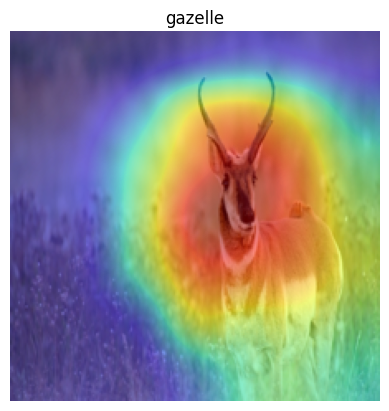

In [7]:
# Get and show the saliency map of Grad-CAM.
gradcam_sal = gradcam(model, input_tensor, input_size=input_size)

tensor_imshow(input_tensor[0])
plt.axis('off')
plt.title(get_class_name(classes))
plt.imshow(gradcam_sal, cmap='jet', alpha=0.5)
plt.show()

100%|██████████| 6000/6000 [09:28<00:00, 10.55it/s]


best value for k is: 1


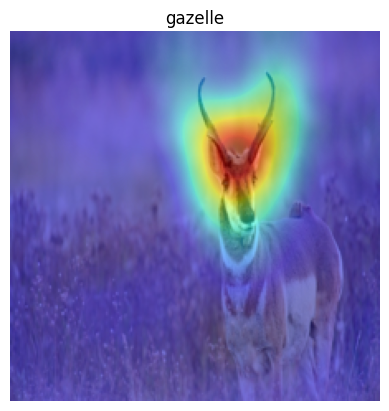

In [8]:
# Get and show the saliency map of RISE-CAM.
risecam_sal = risecam(model, input_tensor, input_size=input_size, mask_path='masks_6000.npy')

tensor_imshow(input_tensor[0])
plt.axis('off')
plt.title(get_class_name(classes))
plt.imshow(risecam_sal, cmap='jet', alpha=0.5)
plt.show()

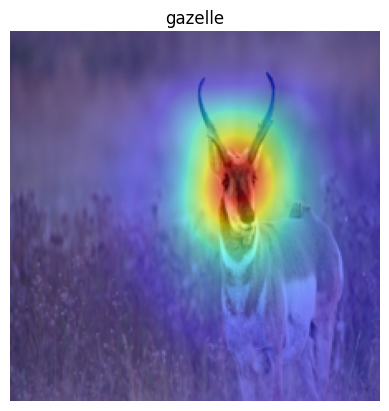

In [9]:
# Get and show the saliency map of RISExCAM.
risexcam_sal = np.multiply(rise_sal, gradcam_sal)

tensor_imshow(input_tensor[0])
plt.axis('off')
plt.title(get_class_name(classes))
plt.imshow(risexcam_sal, cmap='jet', alpha=0.5)
plt.show()

## Evaluating metrics: insertion and deletion
For insertion, pixels will be gradually added to the image in the sequence of their importance given by the saliency map, and the change in confidence will be tracked when fed into the model. The score will be the area under the curve. The higher the score is, the better the saliency map is.

Deletion, on the other hand, deletes the pixels and tracks the drop in confidence. Opposite to insertion, an accurate saliency map will have a low deletion score.

In [10]:
insertion = CausalMetric(model, 'ins', input_size[0], substrate_fn=blur)
deletion = CausalMetric(model, 'del', input_size[0], substrate_fn=torch.zeros_like)

The starting image in the **insertion** process is an blurred image. This is because the input pixels will usually form an oval resulting in the misclassification of the model (might classify it as a ballon or other oval shape objects).

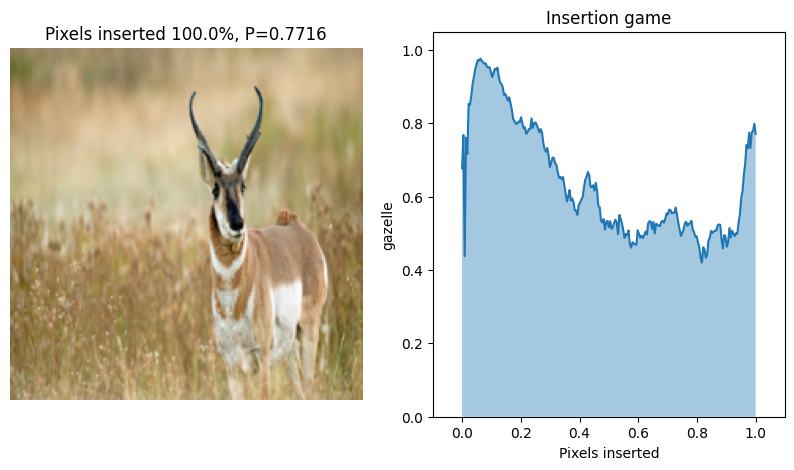

In [11]:
insertion_scores = insertion.single_run(input_tensor, risecam_sal, input_size[0]*input_size[1], verbose=1)

The final image in the **deletion** process is an all-zero image. It is gray instead of black, because we are setting pixels to $0$ in the space of normalized images. Deletion does not encounter the shape problem in the insertion, so the deleted pixels will be set to zero.

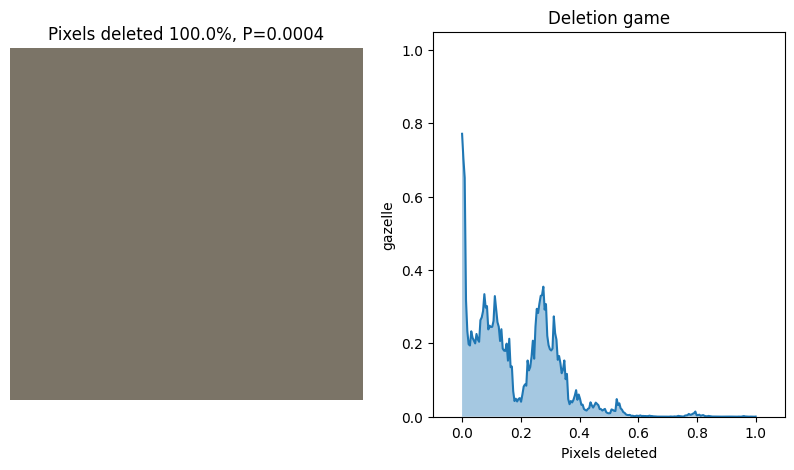

In [12]:
deletion_scores = deletion.single_run(input_tensor, risecam_sal, input_size[0]*input_size[1], verbose=1)

## Comparison between RISE, Grad-CAM, RISE-CAM, and RISExCAM
Demonstrate the comparison between RISE, Grad-CAM, RISE-CAM, and RISExCAM on the saliency maps, insertion, and deletion. Most images encountered a confidence drop after the peak in the 0% to 20% range (see the curve in the previous session). At the same time, the confidence of deletion was insignificant after the same range of around 20%. Consequently, there will be five scores shown: insertion, deletion, top 20% insertion (area under the top 20% insertion curve), top 20% deletion (area under the top 20% deletion curve), and **top 20% insertion - top 20% deletion**.

In [13]:
# Show the image with overlays and the scores of each algorithms. This function will return the scores.
def show_comparison(saliencies, img, names=[], verbose=True):
    if verbose:
        plt.figure(figsize=(20, 5))
        
        plt.subplot(151)
        plt.axis('off')
        p, c = torch.topk(model(img.cuda()), 1)
        plt.title('{}: {:.1f}%'.format(get_class_name(c), 100 * float(p)))
        tensor_imshow(img[0])

    scores = np.zeros((len(saliencies), 5))

    if(len(names) != len(saliencies)):
        names = ['algorithm {}'.format(i) for i in range(len(saliencies))]

    for i, saliency in enumerate(saliencies):
        deletion_sal = deletion.single_run(img, saliency, input_size[0]*input_size[1])
        scores[i][0] = auc(deletion_sal)
        scores[i][1] = auc(deletion_sal, fraction=0.2)
        insertion_sal = insertion.single_run(img, saliency, input_size[0]*input_size[1])
        scores[i][2] = auc(insertion_sal)
        scores[i][3] = auc(insertion_sal, fraction=0.2)
        scores[i][4] = scores[i][3] - scores[i][1]

        if verbose:
            plt.subplot(152+i)
            plt.axis('off')
            tensor_imshow(img[0])
            plt.imshow(saliency, alpha=0.5, cmap='jet')
            plt.title('{}: {:.3f} / {:.3f} / {:.3f} / {:.3f} / {:.3f}'.format(
                names[i],
                scores[i][0],
                scores[i][1],
                scores[i][2],
                scores[i][3],
                scores[i][4]
            ), fontsize=9)
    
    if verbose:
        plt.show()

    return scores

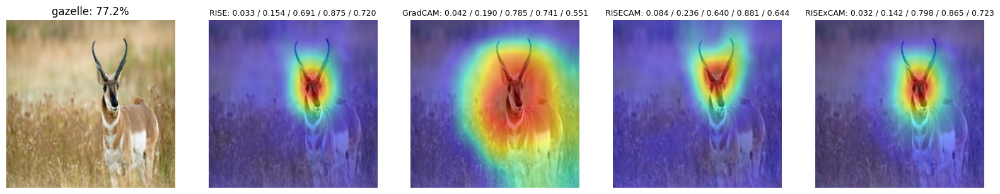

In [14]:
# Input the previously generate the saliency maps, show the explanation, and compute the scores.
scores = show_comparison(
    [rise_sal, gradcam_sal, risecam_sal, risexcam_sal],
    input_tensor,
    names=['RISE', 'GradCAM', 'RISECAM', 'RISExCAM']
)

### Select the images that the model predicts corecctly and confidently

In [15]:
# Execute this code if animal_list.json does not exist.
animal_list = []
for animal in os.listdir('animals'):
    p = 0
    for img_name in os.listdir('animals/{}'.format(animal)):
        img = read_tensor('animals/{}/{}'.format(animal, img_name))

        probability, class_number = torch.topk(model(img.cuda()), k=1)
        probability, class_number = probability[0], class_number[0]

        if((probability.item() > 0.7) & (animal in get_class_name(class_number))):
            animal_list.append('animals/{}/{}'.format(animal, img_name))
            break # The size of the dataset will be around 50 if this line is commented out. Otherwise, around 2000. 

for i , item in enumerate(animal_list):
    print(i, item)

# Save the paths of the images.
with open('animal_list.json', 'w') as json_file:
    animal_list = json.dump(animal_list, json_file)

0 animals/badger/00f56e5c92.jpg
1 animals/bear/039b2ae790.jpg
2 animals/bee/0d562e4829.jpg
3 animals/beetle/02b34c63a2.jpg
4 animals/bison/02116e752c.jpg
5 animals/boar/0903d0db72.jpg
6 animals/cat/029c926ce9.jpg
7 animals/chimpanzee/00981a3b70.jpg
8 animals/cockroach/01af9577d7.jpg
9 animals/coyote/004c3aef03.jpg
10 animals/crab/0a3d16566f.jpg
11 animals/dog/5c641a8bde.jpg
12 animals/dragonfly/0a859ff327.jpg
13 animals/eagle/0572b4375b.jpg
14 animals/elephant/0c57e72045.jpg
15 animals/flamingo/01a80454b4.jpg
16 animals/fly/0107bf9fa0.jpg
17 animals/fox/046e05e07b.jpg
18 animals/goldfish/0173d47eb4.jpg
19 animals/goose/013aff2835.jpg
20 animals/gorilla/01a857d803.jpg
21 animals/grasshopper/021affcbac.jpg
22 animals/hamster/016f41b537.jpg
23 animals/hare/01d3d9ad9a.jpg
24 animals/hippopotamus/004d703f95.jpg
25 animals/hornbill/000ef44b56.jpg
26 animals/hummingbird/00d1730748.jpg
27 animals/hyena/0041c9ff2c.jpg
28 animals/jellyfish/05b20e2efa.jpg
29 animals/koala/0042f2effe.jpg
30 animal

In [ ]:
# Load the selected images if animal_list.json exist.
with open('animal_list.json', 'r') as json_file:
    animal_list = json.load(json_file)

In [14]:
# Load the previously computed scores to skip the evaluated images.
# score_list = []
score_list = list(np.load('score_list.npy')) # Comment out this line and use the previous line if score_list.npy does not exist.
animal_list = animal_list[len(score_list):]

### Evaluation
Evaluate the scores of the algorithms based on the selected images. This will take a long time to execute (10 mins per image for a RTX2080ti GPU).

Loading masks.


100%|██████████| 6000/6000 [10:19<00:00,  9.69it/s]


0 0.7784138597079702
2 0.7903006210564688


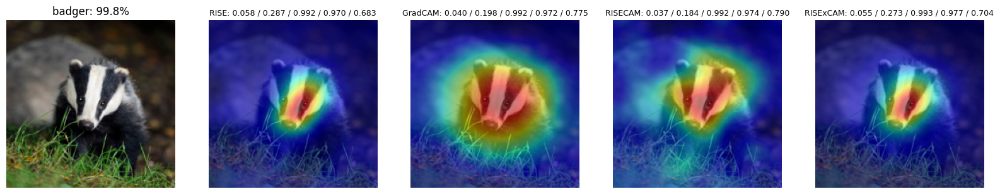

Loading masks.


100%|██████████| 6000/6000 [10:20<00:00,  9.68it/s]


0 -0.0365271947600625
3 -0.023978198793801364
4 -0.02071122012355109
5 -0.020196994597261653
6 -0.018376467580145106
18 -0.017377917739478055


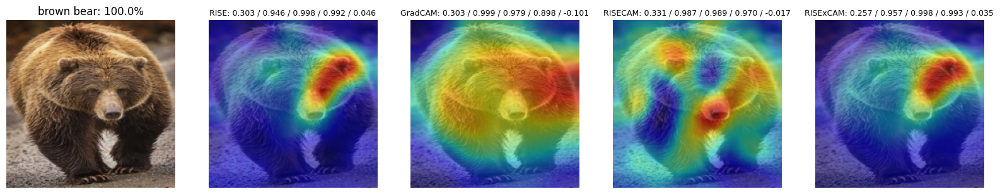

Loading masks.


100%|██████████| 6000/6000 [10:13<00:00,  9.79it/s]


0 0.5140621656636623


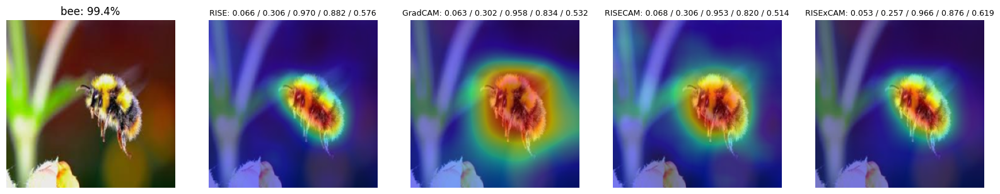

Loading masks.


100%|██████████| 6000/6000 [10:24<00:00,  9.60it/s]


0 0.10907732197004161
1 0.13950053665030276
2 0.1950730035962558
3 0.1998679737192685
4 0.2190438095302935
5 0.2437919460631251
7 0.24528445815270639
8 0.2646300214229004
9 0.2752942599009574
11 0.2820024831995728


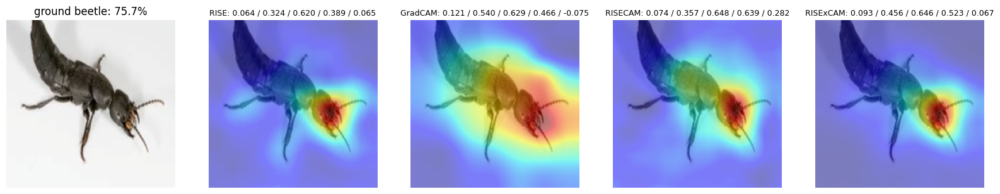

Loading masks.


100%|██████████| 6000/6000 [10:21<00:00,  9.65it/s]


0 -0.6013281618625941
1 0.12754851205549622
7 0.14820834922350262
8 0.16272070458547788
9 0.1880192046519369
11 0.2807061297141693


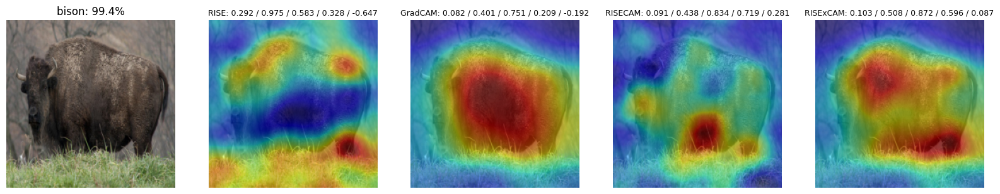

Loading masks.


100%|██████████| 6000/6000 [10:14<00:00,  9.77it/s]


0 0.15289433808489283


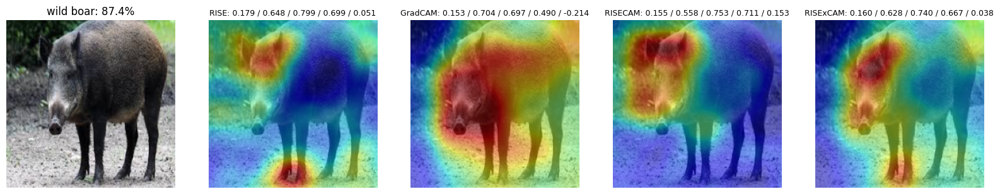

Loading masks.


100%|██████████| 6000/6000 [10:25<00:00,  9.59it/s]


0 0.48271914715455333


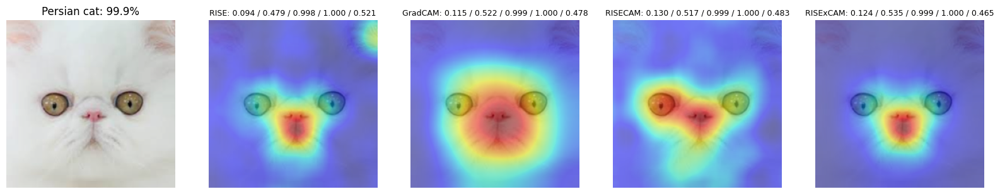

Loading masks.


100%|██████████| 6000/6000 [10:25<00:00,  9.59it/s]


0 0.38580603402277286
1 0.5325578043491326
4 0.5624374561011791


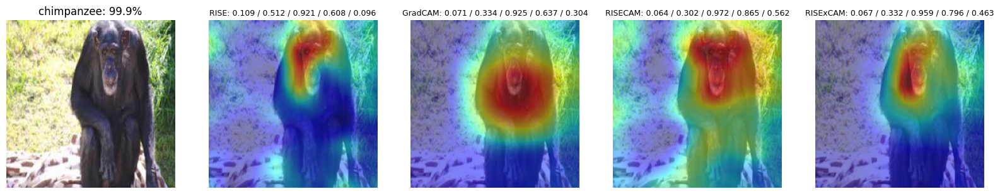

Loading masks.


100%|██████████| 6000/6000 [10:23<00:00,  9.62it/s]


0 0.13316439941329666
2 0.19661394858452358
11 0.32426749274468003
12 0.4733681998795046
13 0.47458634540750855
18 0.488147657162203
19 0.5161401703834682


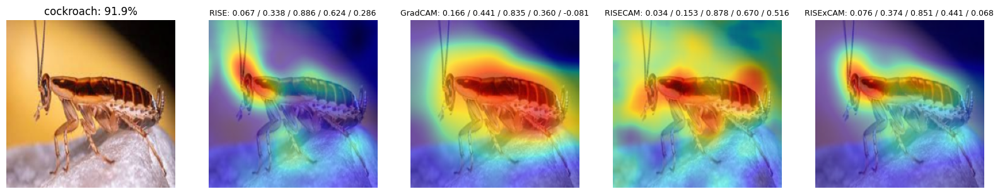

Loading masks.


100%|██████████| 6000/6000 [10:23<00:00,  9.63it/s]


0 -0.1378387537869541
1 0.04105724027943902
5 0.1556835922264409
8 0.22193857538116968


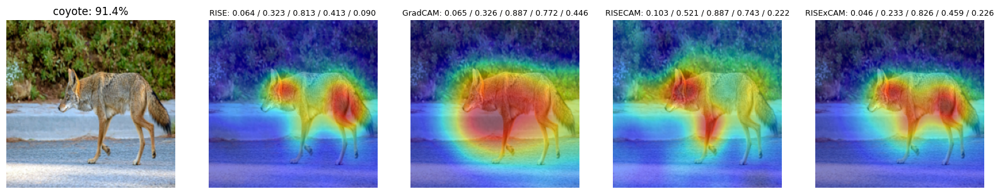

Loading masks.


100%|██████████| 6000/6000 [10:39<00:00,  9.39it/s]


0 -0.3389836466574872
15 -0.3001372020014308
22 -0.29253059027674183
23 -0.25296070716682484
24 -0.19193230981578707
25 -0.12797322025818925


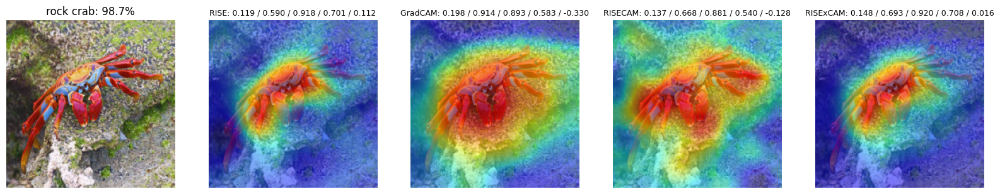

Loading masks.


100%|██████████| 6000/6000 [11:26<00:00,  8.74it/s] 


0 0.15472081203055993
1 0.20802322998960415
2 0.3262163155807436
4 0.33294793890937313
5 0.339286678084384
6 0.41515398418414406
8 0.44877633095232095
9 0.45417541382961313
13 0.4553183766957689
14 0.4738437469694129
15 0.4768303725842006


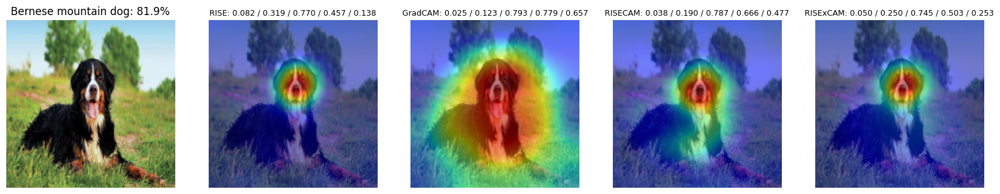

Loading masks.


100%|██████████| 6000/6000 [10:59<00:00,  9.09it/s]


0 -0.4100776561112567
36 -0.4025635790418495
37 -0.38540668531574995
38 -0.3767694004557349
39 -0.371895915066654
40 -0.3425548100336031


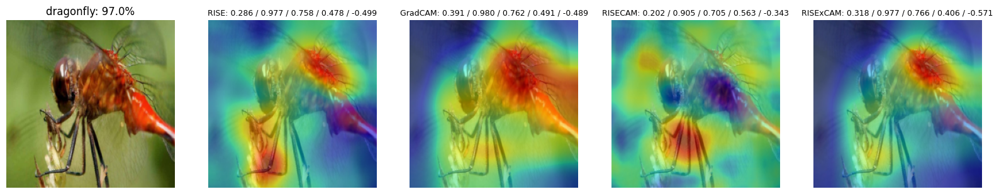

Loading masks.


100%|██████████| 6000/6000 [10:47<00:00,  9.27it/s]


0 0.5792609307860733
1 0.5830451012761014
5 0.5844991289883513
7 0.5890636311272498
9 0.5958739327060439
10 0.5988836766198139
23 0.5999167744184062
24 0.6006832604391754
25 0.6042701317399571
28 0.605142854757353
29 0.6074638825468189
30 0.6087021922073539
36 0.6090268003225157
38 0.6091024294040503
41 0.6103716049057601
43 0.611242531195537
47 0.6117581823756072
48 0.6120689093685624


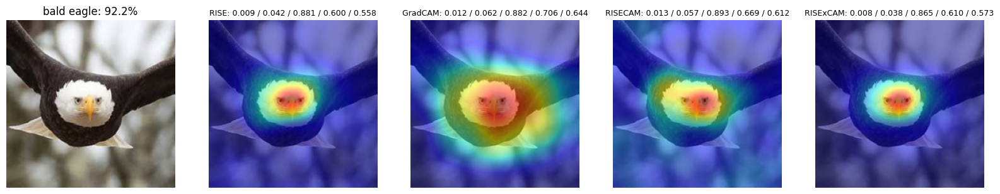

Loading masks.


100%|██████████| 6000/6000 [10:42<00:00,  9.34it/s]


0 -0.45691369846463203
1 -0.33483773944052786
2 -0.19423127860169517
3 -0.09437171882018447
4 0.015950384803793627


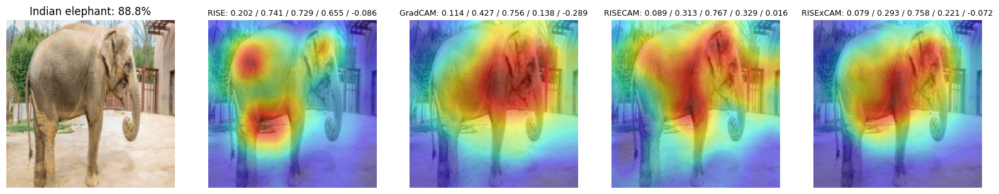

Loading masks.


100%|██████████| 6000/6000 [10:15<00:00,  9.75it/s]


0 0.0021607367829842294
1 0.00981630723584781
15 0.014151018451560637
17 0.024868165227499794
22 0.03779396211559116


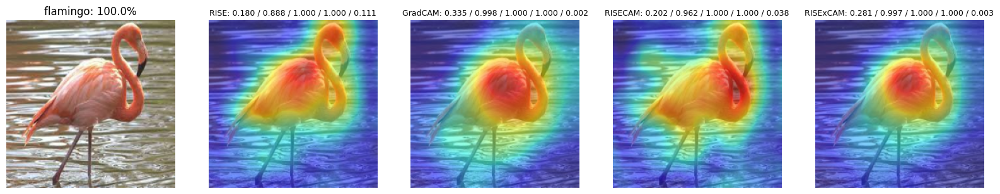

Loading masks.


100%|██████████| 6000/6000 [10:24<00:00,  9.61it/s]


0 0.12977063184993387
2 0.14093965067025815
3 0.1666648473603387
4 0.18241697900841491


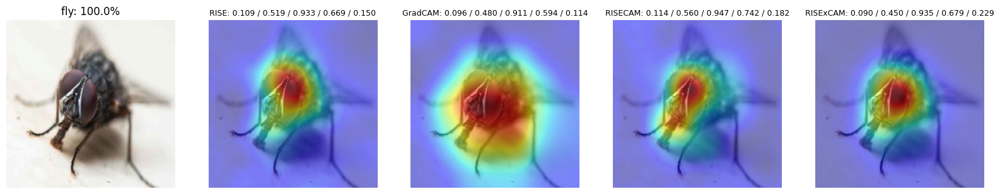

Loading masks.


100%|██████████| 6000/6000 [10:24<00:00,  9.61it/s]


0 -0.0007443041964011465
15 0.00814921883019537
16 0.008311146362261268
18 0.02002782781015744
20 0.020854532718658447
21 0.03350462019443512
29 0.048846401274204254
30 0.0572145899588411
31 0.06869707121090451


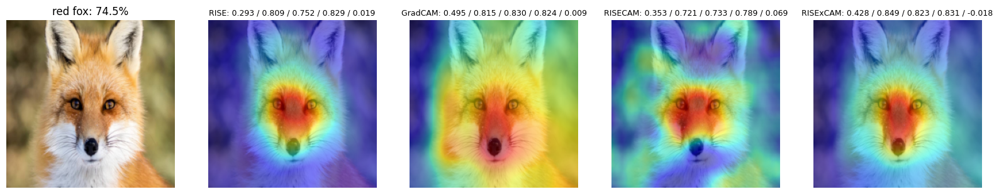

Loading masks.


100%|██████████| 6000/6000 [10:26<00:00,  9.58it/s]


0 0.05740036273544491
15 0.06798301840370347
16 0.08456727388230234
17 0.08560273525389761
20 0.11621805077249359
21 0.2632235271686858
24 0.3048591024496339
25 0.43210472843863745


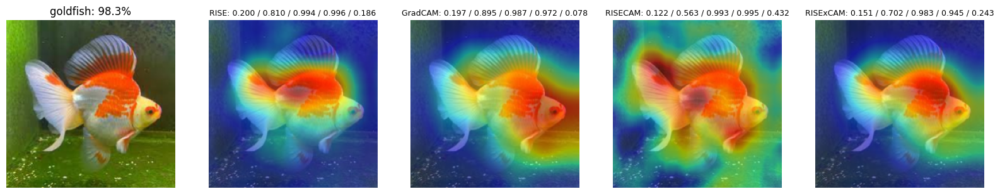

Loading masks.


100%|██████████| 6000/6000 [10:25<00:00,  9.60it/s]


0 0.2851668228554031
2 0.34180089713217143
4 0.4906684312604326
6 0.6301920458261685
10 0.6485981022097721
11 0.7170384130996271
14 0.7288015741029417


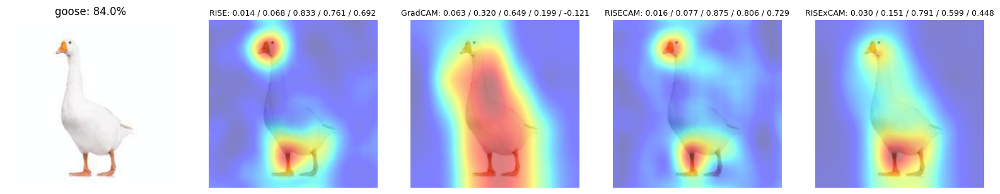

Loading masks.


100%|██████████| 6000/6000 [10:24<00:00,  9.61it/s]


0 0.520092872365653
3 0.5450803242592056


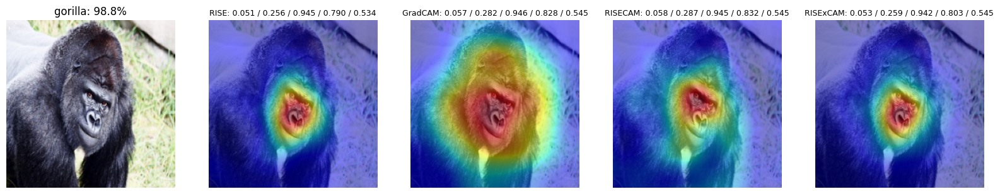

Loading masks.


100%|██████████| 6000/6000 [10:22<00:00,  9.64it/s]


0 -0.2734580788369799
2 -0.19169951430045656
6 -0.03531745664606034
8 0.01598208174321125
10 0.020273875921371975
30 0.04427114936300891
32 0.054409382745771784
33 0.057060872692752285
34 0.06386559946126491
35 0.08892951943033212
37 0.10159463132202462


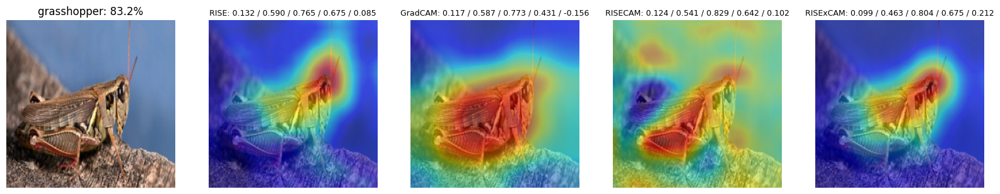

Loading masks.


100%|██████████| 6000/6000 [10:22<00:00,  9.64it/s]


0 0.7952711256062188
22 0.7959061154503038
26 0.7963673319794576
27 0.79734686559426
30 0.8051998639394613
31 0.8134445745011114
34 0.8138886918737129
39 0.8192741150269285


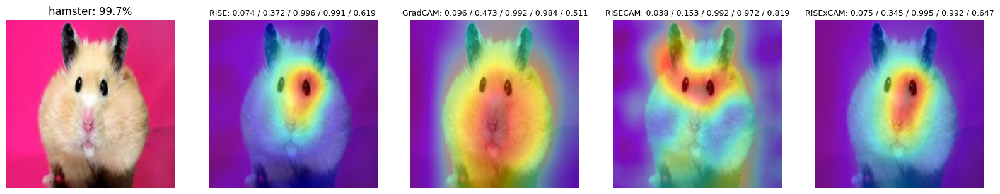

Loading masks.


100%|██████████| 6000/6000 [10:22<00:00,  9.64it/s]


0 -0.08273595695407658
1 0.26051951583411376
2 0.3433614498459395


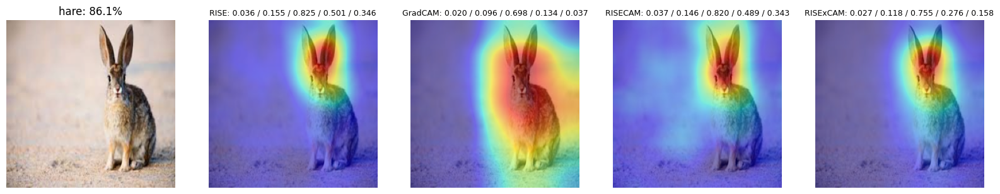

Loading masks.


100%|██████████| 6000/6000 [10:23<00:00,  9.63it/s]


0 -0.07130734216083179
1 -0.0611218085343187
29 -0.0446263572031802
31 -0.018574665215882358
32 -0.005430880595337251
33 -0.003504927185448703
41 0.00970320234244526
42 0.020799352702769336
43 0.03959347951141279
44 0.042657069861888885
45 0.05816320770166139
46 0.06313874081454496


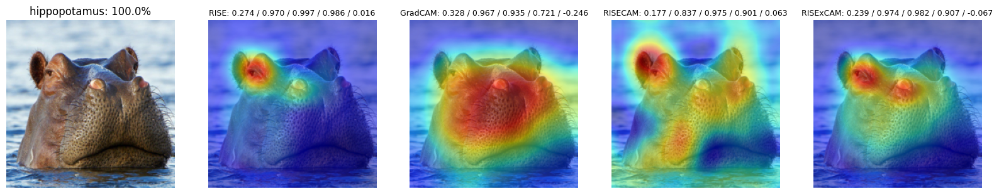

Loading masks.


100%|██████████| 6000/6000 [10:22<00:00,  9.63it/s]


0 0.2544160469121628
1 0.3316105970999078
2 0.33624662078959355
3 0.34441235508446966
6 0.3554150464796377
7 0.3587206442184238
8 0.3691881355639039


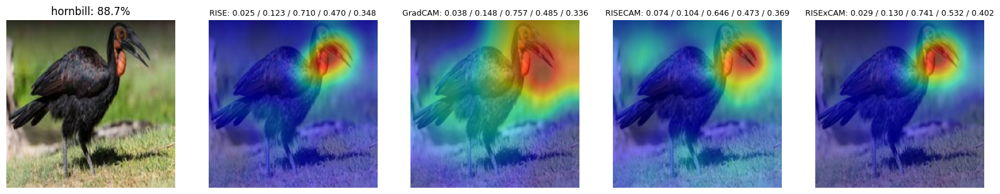

Loading masks.


100%|██████████| 6000/6000 [10:19<00:00,  9.68it/s]


0 -0.02878215638074011
3 0.13662758219288668


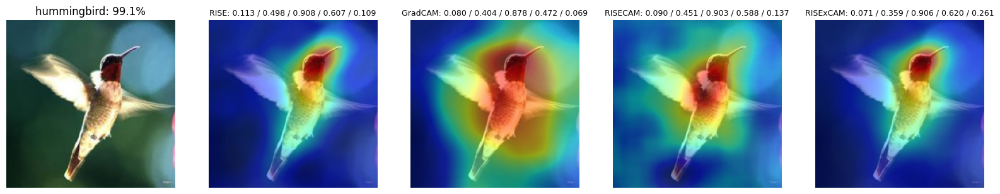

Loading masks.


100%|██████████| 6000/6000 [10:17<00:00,  9.72it/s]


0 -0.3402156551283869
1 -0.2820403412492437
2 -0.2229442750950429
18 -0.19545710723931814
19 -0.16816273190885445


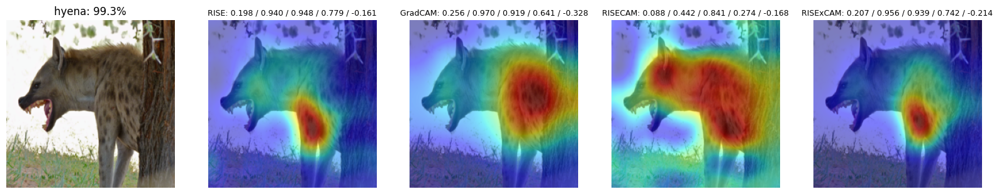

Loading masks.


100%|██████████| 6000/6000 [10:16<00:00,  9.73it/s]


0 -0.3112885431301865
2 -0.2859993444078348


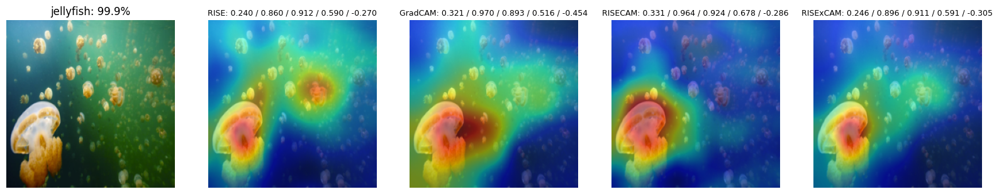

Loading masks.


100%|██████████| 6000/6000 [10:19<00:00,  9.68it/s]


0 -0.15524256560125982
4 -0.14180306858510117
5 -0.1302388016007502
7 -0.11815641624112189
8 -0.11444160992554811


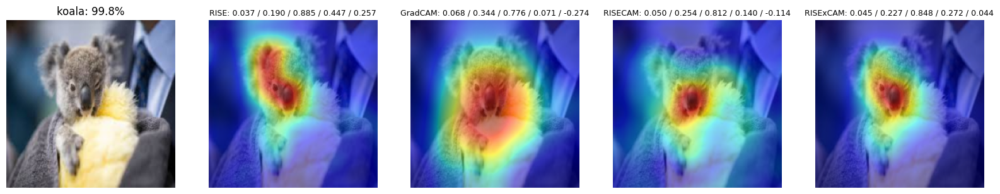

Loading masks.


100%|██████████| 6000/6000 [10:15<00:00,  9.75it/s]


0 -0.06172977178357547
1 0.003107984042303058
4 0.012162203265523419
5 0.03869072470644663
14 0.06266915628855885
15 0.07078036750582128
18 0.11748479213565588


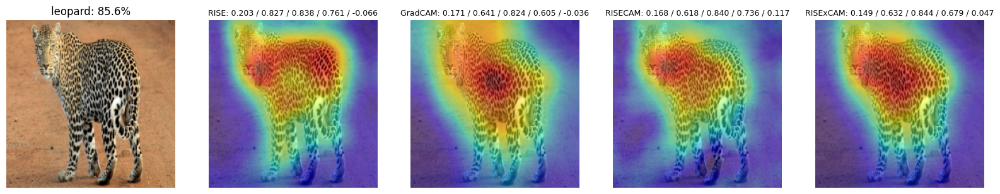

Loading masks.


100%|██████████| 6000/6000 [10:17<00:00,  9.71it/s]


0 0.5814242002836015
1 0.6268268775427879
2 0.6417433425835539
3 0.6430744517131396
4 0.6480921884164921


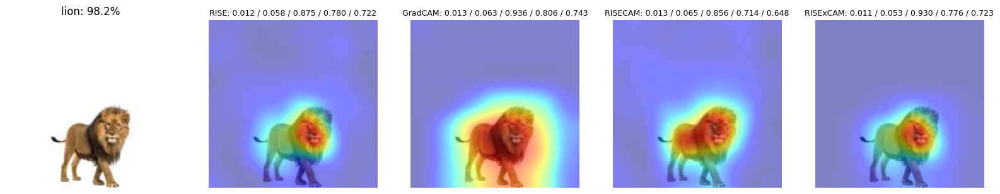

Loading masks.


100%|██████████| 6000/6000 [10:20<00:00,  9.67it/s]


0 0.03683595193640277
1 0.07438940957813012
5 0.08917224553641226
6 0.14155194203125246
7 0.20651456385911093


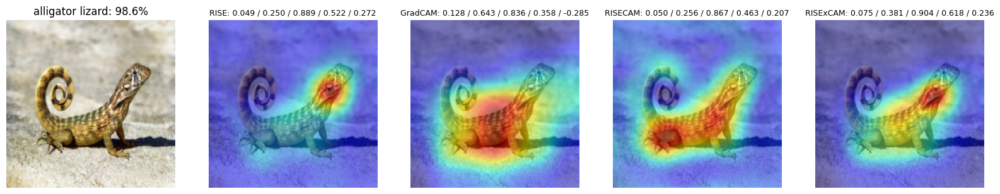

Loading masks.


100%|██████████| 6000/6000 [10:17<00:00,  9.71it/s]


0 0.12835995045448223
5 0.1482546425593847
9 0.15815958696078847
19 0.15982662517027085
20 0.1659601594702425


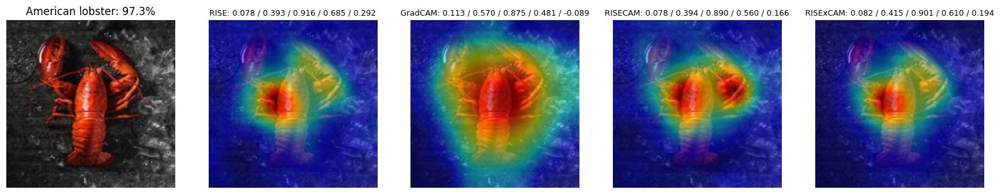

Loading masks.


100%|██████████| 6000/6000 [10:17<00:00,  9.72it/s]


0 0.3808519532904029
1 0.5179636964405125


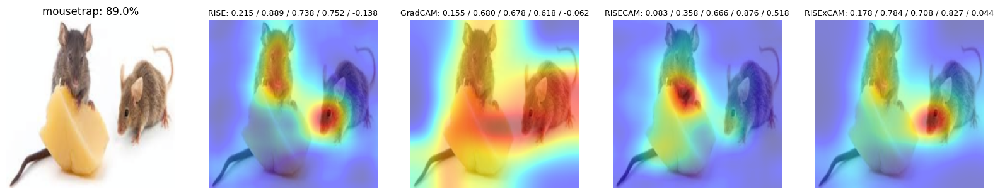

Loading masks.


100%|██████████| 6000/6000 [10:30<00:00,  9.52it/s]


0 0.25727124918590893


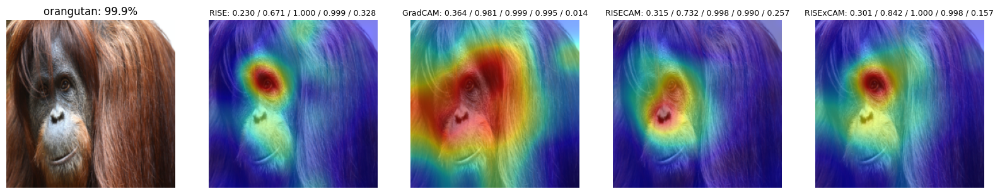

Loading masks.


100%|██████████| 6000/6000 [10:16<00:00,  9.73it/s]


0 0.4049155828966336
1 0.4200369813267819
8 0.45988301644948393


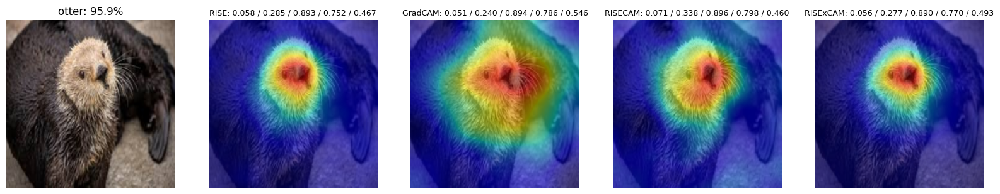

Loading masks.


100%|██████████| 6000/6000 [10:17<00:00,  9.71it/s]


0 -0.5230585594503778
2 -0.4670480427342806
37 -0.46006387854669645


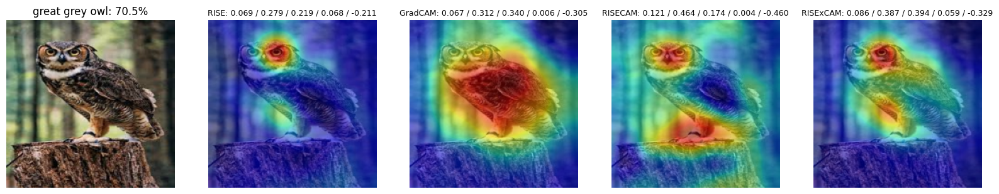

Loading masks.


100%|██████████| 6000/6000 [10:18<00:00,  9.71it/s]


0 -0.17077223465523939
2 -0.11503245512192906
13 0.01980768421410839


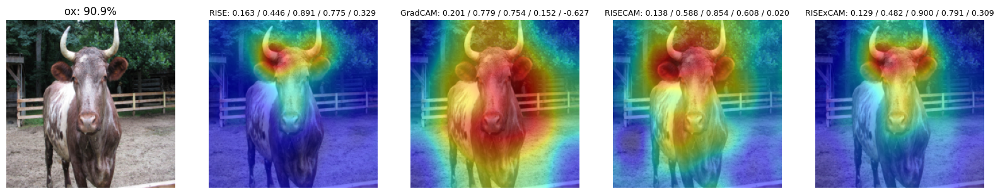

Loading masks.


100%|██████████| 6000/6000 [10:19<00:00,  9.69it/s]


0 -0.049652529351243924
1 -0.04618718738625334
3 -0.02277696797285568
8 -0.02266834088897502
10 -0.02022586459696124
11 0.030849856718718496


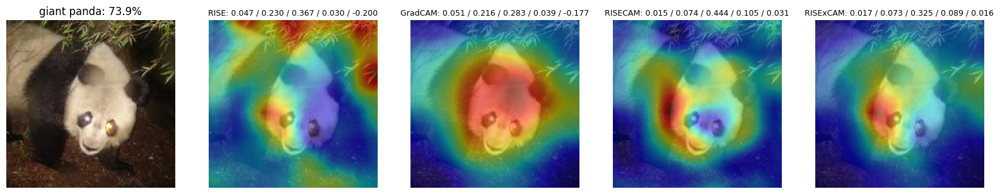

Loading masks.


100%|██████████| 6000/6000 [10:17<00:00,  9.71it/s]


0 -0.23353620991110802
1 -0.06449920819564303
2 -0.04293265803293744


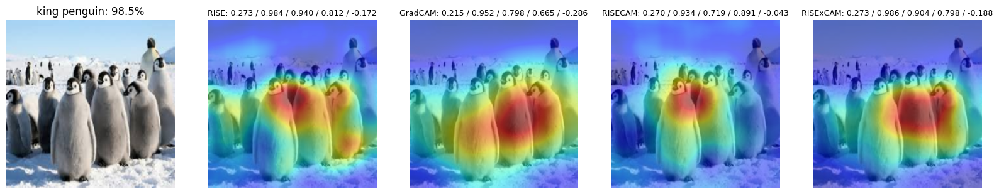

Loading masks.


100%|██████████| 6000/6000 [10:15<00:00,  9.75it/s]


0 -0.09328369168731981
3 -0.08199163943784656
5 -0.05909477884241905
6 -0.016829481718306477


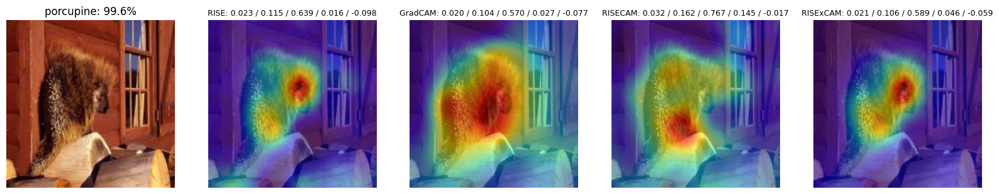

Loading masks.


100%|██████████| 6000/6000 [10:16<00:00,  9.72it/s]


0 0.5420344353822821


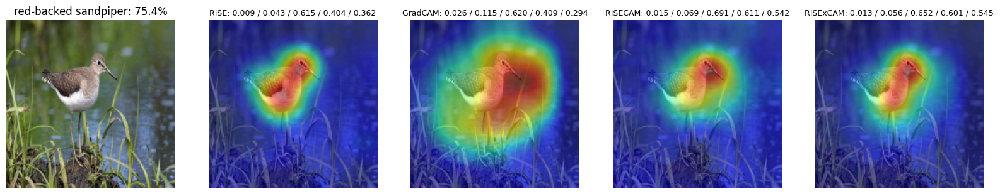

Loading masks.


100%|██████████| 6000/6000 [10:15<00:00,  9.75it/s]


0 0.5621415560219082
1 0.6173349628129058


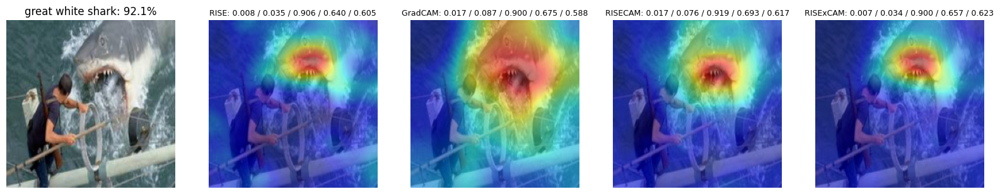

Loading masks.


100%|██████████| 6000/6000 [10:16<00:00,  9.73it/s]


0 -0.17450728845274585
1 -0.17252701160429174
4 -0.17168207149172138
5 -0.15625692836932684
15 -0.12809413493687316
16 -0.09800060563355312
17 -0.08006966992351491
18 -0.05831823645231214
27 -0.049829776701781986
29 -0.04730141888880594


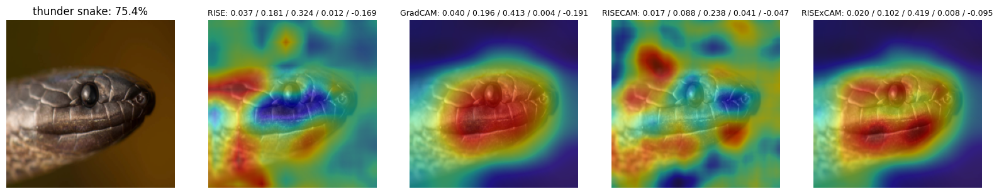

Loading masks.


100%|██████████| 6000/6000 [10:15<00:00,  9.74it/s]


0 -0.08190716125748376
1 -0.06152118810198526
4 -0.0582051189108328
5 -0.0476067946715788
13 -0.04039513251998206
14 0.005304950204762515
16 0.06146247176961461
17 0.12374564124779264
18 0.2745647165416316
19 0.38221812121231447
21 0.38398134335875506
22 0.46043856238776987
23 0.5156689383597537
24 0.5752792735795744
25 0.5775617966640063
28 0.5835795205996626
31 0.6029465183700351
32 0.6097716653550213
35 0.6175837631189179


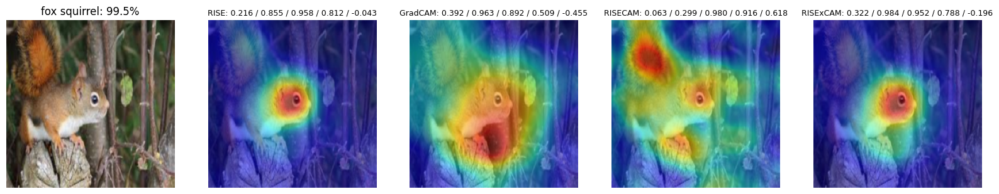

Loading masks.


100%|██████████| 6000/6000 [10:23<00:00,  9.62it/s]


0 0.6166869967551479


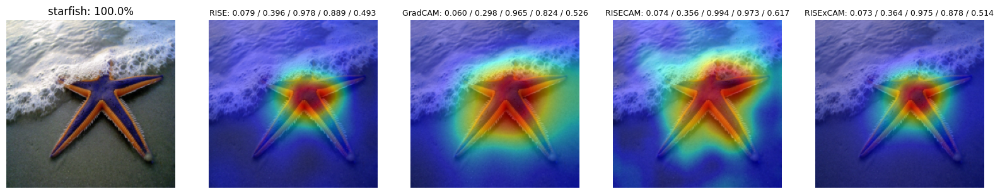

Loading masks.


100%|██████████| 6000/6000 [10:16<00:00,  9.74it/s]


0 0.0017322884364562308
3 0.002809458158232858


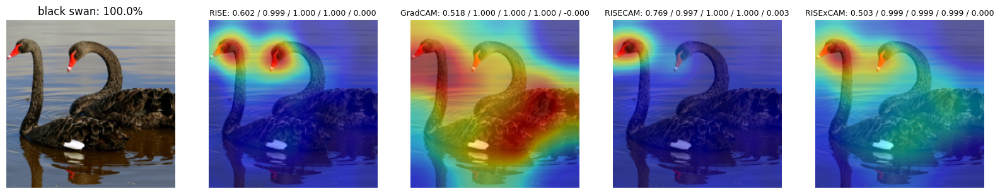

Loading masks.


100%|██████████| 6000/6000 [10:19<00:00,  9.68it/s]


0 -0.0880509225693955
1 -0.08491051421416085
2 -0.02983378686688165
4 -0.02692620659416367
8 -0.019667256623506546
11 -0.01828731799667538
12 -0.0023918673396110535


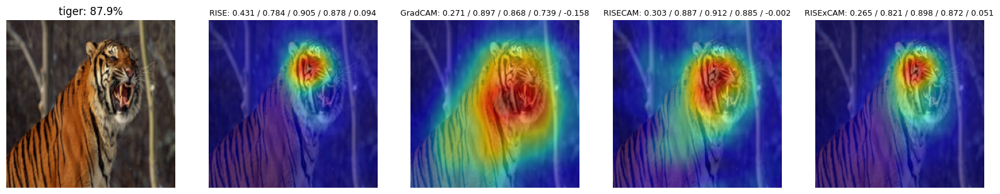

Loading masks.


100%|██████████| 6000/6000 [10:39<00:00,  9.39it/s]


0 -0.11448341404849838


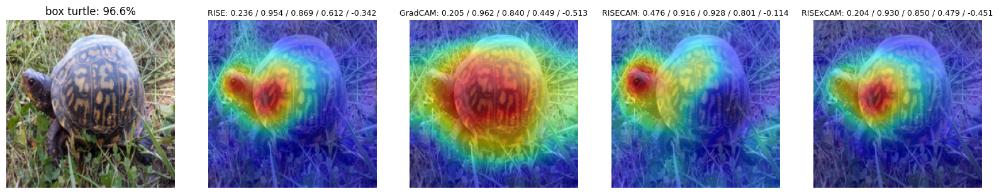

Loading masks.


100%|██████████| 6000/6000 [10:11<00:00,  9.81it/s]


0 0.3723038079121827
2 0.44739954878406774


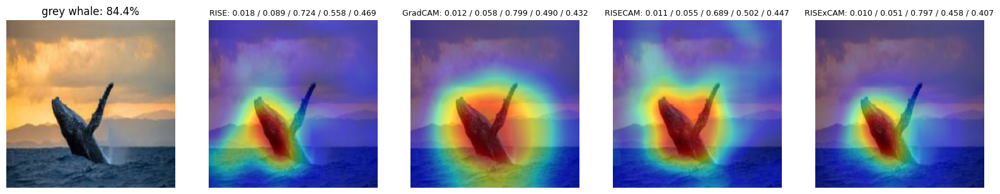

Loading masks.


100%|██████████| 6000/6000 [10:10<00:00,  9.83it/s]


0 0.11318154666911473
1 0.12275000111284579
2 0.14028712302785035
8 0.14186395438049332
12 0.14374686464328656
14 0.1439786664718254
15 0.145924074321308
16 0.14782899795946747


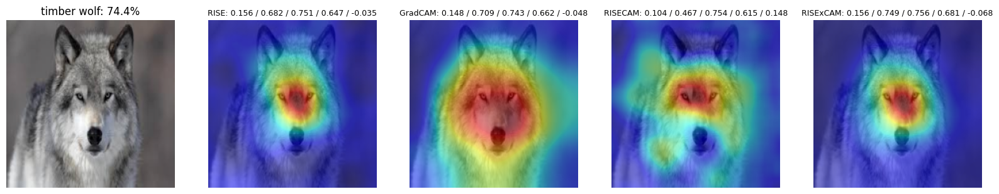

Loading masks.


100%|██████████| 6000/6000 [10:14<00:00,  9.77it/s]


0 -0.6290556267724076
1 -0.5785956776446917
3 -0.4829627240251284
6 -0.47124114636839787
26 -0.4556396425548221
31 -0.44770914533662354
32 -0.4319966102722736
33 -0.42101813667316246
34 -0.41322783486314374


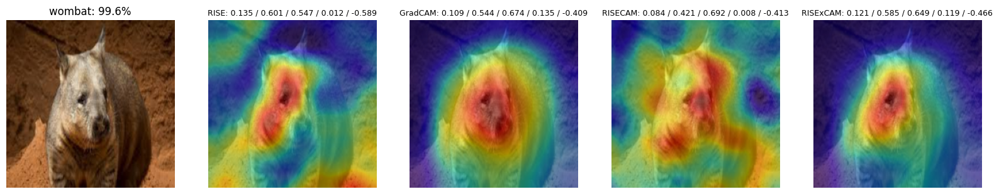

Loading masks.


100%|██████████| 6000/6000 [10:10<00:00,  9.82it/s]


0 -0.005514672534032261
1 -0.00458082759922207
2 -0.0033644051714376566
4 -0.002661476081067926
5 -0.0019110813736915588
10 -0.0012035159902138437
30 0.004768330265175202


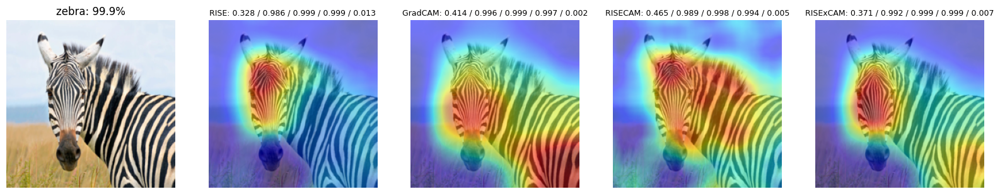

In [13]:
# Explain all the selected images.
for img_path in animal_list:
    img = read_tensor(img_path)
    
    # Generate saliency maps.
    rise_sal = rise(model, img, mask_path='masks_6000.npy')
    gradcam_sal = gradcam(model, img)
    risecam_sal = risecam(model, img, mask_path='masks_6000.npy')
    risexcam_sal = np.multiply(rise_sal, gradcam_sal)
    
    # Show the explanation, compute the scores and append them in the list.
    scores = show_comparison(
        [rise_sal, gradcam_sal, risecam_sal, risexcam_sal],
        img,
        names=['RISE', 'GradCAM', 'RISECAM', 'RISExCAM'],
        verbose=True # No image will be shown if the verbose is set false. 
    )
    score_list.append(scores)

    # save the scores in scores.txt in case the computer crashes.
    with open('scores.txt', 'w') as f:
        f.write(str(np.array(score_list).mean(axis=0)))

In [ ]:
# Save the scores.
np.save('score_list.npy', score_list)

In [14]:
# Show the mean of the scores.
np.array(score_list).mean(axis=0)

array([[0.14152902, 0.51639455, 0.82990284, 0.65375323, 0.13735867],
       [0.15270461, 0.5375249 , 0.81820308, 0.56739838, 0.02987348],
       [0.13315038, 0.44673841, 0.83223433, 0.66900996, 0.22227155],
       [0.13240557, 0.49568742, 0.84071755, 0.64517861, 0.1494912 ]])

In [15]:
# Show the standard deviation of the scores.
np.array(score_list).std(axis=0)

array([[0.1190378 , 0.3166699 , 0.17432684, 0.27124712, 0.32047431],
       [0.130827  , 0.32279611, 0.16029909, 0.29714926, 0.36175929],
       [0.14184195, 0.29507725, 0.17128553, 0.27411783, 0.31179912],
       [0.11560927, 0.32116058, 0.15361962, 0.26994373, 0.30704731]])